# Part 2  

# Outliers 

In [36]:
df_numeric = df._get_numeric_data()
for i in df_numeric:
    fig = px.box( df_numeric[i] , title='Box plot distribution of ' + i)
    fig.show()

In [37]:
df_numeric = df._get_numeric_data()
#df_numeric

In [38]:
column     =[]

Q1_value   =[]
Q3_value   =[]
IQR_value  =[]

lower_whisker_value =[]
upper_whisker_value =[]


df_numeric1 =df_numeric.iloc[:,[0,2,5]] #only take age,educational-num ,hours-per-week columns

for i in df_numeric1:
    
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    IQR = Q3 - Q1
    whisker_width = 1.5
    lower_whisker = Q1 - (whisker_width*IQR)
    upper_whisker = Q3 + (whisker_width*IQR)
    df[i]=np.where(df[i]>upper_whisker,upper_whisker,
                            np.where(df[i]<lower_whisker,lower_whisker,df[i]))
    
    column.append(i)
    Q1_value.append(Q1)
    Q3_value.append(Q3)
    IQR_value.append(IQR)
    lower_whisker_value.append(lower_whisker)
    upper_whisker_value.append(upper_whisker)
    
outliers_summary = pd.DataFrame({"Numeric_column":column , 
                      "25_percentile_value":Q1_value, 
                      "75_percentile_value": Q3_value ,
                      "IQR_range": IQR_value , 
                      "lower_whisker_value":lower_whisker_value ,
                     "upper_whisker_value" : upper_whisker_value } )
outliers_summary

,Numeric_column,25_percentile_value,75_percentile_value,IQR_range,lower_whisker_value,upper_whisker_value
0,age,28.0,48.0,20.0,-2.0,78.0
1,educational-num,9.0,12.0,3.0,4.5,16.5
2,hours-per-week,40.0,45.0,5.0,32.5,52.5


In [39]:
num = ['age','educational-num','hours-per-week']
for i in num:
    fig = px.box( df[i] , title='Box plot distribution of ' + i)
    fig.show()

# Convert categorical column to Numeric column

In [40]:
df.info()
# nine columns are categorical --> workclass, education, marital-status, occupation, relationship, race, gender, native-country, income
# by Using replace() method

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48790 entries, 0 to 48789
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   age              48790 non-null  float64
 1   workclass        48790 non-null  object 
 2   fnlwgt           48790 non-null  int64  
 3   education        48790 non-null  object 
 4   educational-num  48790 non-null  float64
 5   marital-status   48790 non-null  object 
 6   occupation       48790 non-null  object 
 7   relationship     48790 non-null  object 
 8   race             48790 non-null  object 
 9   gender           48790 non-null  object 
 10  capital-gain     48790 non-null  int64  
 11  capital-loss     48790 non-null  int64  
 12  hours-per-week   48790 non-null  float64
 13  native-country   48790 non-null  object 
 14  income           48790 non-null  object 
dtypes: float64(3), int64(3), object(9)
memory usage: 5.6+ MB


In [41]:
df["workclass"] = df["workclass"].replace({"Federal-gov" : 0,"Local-gov":1, "Never-worked" : 2, "Private":3, "Self-emp-inc":4, "Self-emp-not-inc":5, "State-gov":6, "Without-pay":7})

df["education"] = df["education"].replace({"Preschool" : 0,"1st-4th":1, "5th-6th" : 2, "7th-8th":3, "9th":4, "10th":5, "11th":6, "12th":7, "HS-grad":8, "Prof-school":9, "Assoc-acdm":10, "Assoc-voc":11, "Some-college":12, "Bachelors":13, "Masters":14, "Doctorate":15})

df["marital-status"] = df["marital-status"].replace({"Divorced" : 0,"Married-AF-spouse":1, "Married-civ-spouse" : 2, "Married-spouse-absent":3, "Never-married":4, "Separated":5, "Widowed":6})

df["occupation"] = df["occupation"].replace({"Adm-clerical":0, "Armed-Forces":1, "Craft-repair":2, "Exec-managerial":3, "Farming-fishing":4, "Handlers-cleaners":5, "Machine-op-inspct":6, "Other-service":7, "Priv-house-serv":8, "Prof-specialty":9, "Protective-serv":10, "Sales":11, "Tech-support":12, "Transport-moving":13})

df["relationship"] = df["relationship"].replace({"Husband":0, "Not-in-family":1, "Other-relative":2, "Own-child":3, "Unmarried":4, "Wife":5})

df["race"] = df["race"].replace({"Amer-Indian-Eskimo":0, "Asian-Pac-Islander":1, "Black":2, "Other":3, "White":4})

df["gender"] = df["gender"].replace({"Female":0, "Male":1})

df["native-country"] = df["native-country"].replace({"Cambodia":0, "Canada":1, "China":2, "Columbia":3, "Cuba":4, "Dominican-Republic":5, "Ecuador":6, "El-Salvador":7, "England":8, "France":9, "Germany":10, "Greece":11, "Guatemala":12, "Haiti":13, "Holand-Netherlands":14, "Honduras":15, "Hong":16, "Hungary":17, "India":18, "Iran":19, "Ireland":20, "Italy":21, "Jamaica":22, "Japan":23, "Laos":24, "Mexico":25, "Nicaragua":26, "Outlying-US(Guam-USVI-etc)":27, "Peru":28, "Philippines":29, "Poland":30, "Portugal":31, "Puerto-Rico":32, "Scotland":33, "South":34, "Taiwan":35, "Thailand":36, "Trinadad&Tobago":37, "United-States":38, "Vietnam":39, "Yugoslavia":40})

df["income"] = df["income"].replace({"<=50K":0, ">50K" :1})


In [42]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48790 entries, 0 to 48789
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   age              48790 non-null  float64
 1   workclass        48790 non-null  int64  
 2   fnlwgt           48790 non-null  int64  
 3   education        48790 non-null  int64  
 4   educational-num  48790 non-null  float64
 5   marital-status   48790 non-null  int64  
 6   occupation       48790 non-null  int64  
 7   relationship     48790 non-null  int64  
 8   race             48790 non-null  int64  
 9   gender           48790 non-null  int64  
 10  capital-gain     48790 non-null  int64  
 11  capital-loss     48790 non-null  int64  
 12  hours-per-week   48790 non-null  float64
 13  native-country   48790 non-null  int64  
 14  income           48790 non-null  int64  
dtypes: float64(3), int64(12)
memory usage: 5.6 MB


# Feature selection with Boruta

In [43]:
df_x = df.iloc[: ,0:-1 ]
df_x.head(5)

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country
0,25.0,3,226802,6,7.0,4,6,3,2,1,0,0,40.0,38
1,38.0,3,89814,8,9.0,2,4,0,4,1,0,0,50.0,38
2,28.0,1,336951,10,12.0,2,10,0,4,1,0,0,40.0,38
3,44.0,3,160323,12,10.0,2,6,0,2,1,7688,0,40.0,38
4,18.0,3,103497,12,10.0,4,9,3,4,0,0,0,32.5,38


In [44]:
df_y = df.iloc[: , -1]
df_y.head(5)

0    0
1    0
2    1
3    1
4    0
Name: income, dtype: int64

In [45]:
df_x1 = df_x
df_x1 =df_x

In [46]:
from sklearn.ensemble import RandomForestClassifier
from boruta import BorutaPy
rf =RandomForestClassifier()
df_x2 = np.array(df_x)
df_y2 = np.array(df_y)

In [47]:
boruta_feature_selector = BorutaPy(rf , max_iter = 25 , verbose =2) 
boruta_feature_selector.fit(df_x2 , df_y2)

Iteration: 	1 / 25
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	2 / 25
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	3 / 25
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	4 / 25
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	5 / 25
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	6 / 25
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	7 / 25
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	8 / 25
Confirmed: 	6
Tentative: 	0
Rejected: 	8


BorutaPy finished running.

Iteration: 	9 / 25
Confirmed: 	6
Tentative: 	0
Rejected: 	8


BorutaPy(estimator=RandomForestClassifier(n_estimators=1000,
                                          random_state=RandomState(MT19937) at 0x28717C92740),
         max_iter=25, random_state=RandomState(MT19937) at 0x28717C92740,
         verbose=2)

In [48]:
boruta_feature_selector.support_

array([ True, False,  True, False,  True,  True, False,  True, False,
       False,  True, False, False, False])

In [49]:
feature_imp = pd.DataFrame({"Importance": boruta_feature_selector.support_ , "Feature_name": df_x1.columns})
feature_imp

,Importance,Feature_name
0,True,age
1,False,workclass
2,True,fnlwgt
3,False,education
4,True,educational-num
5,True,marital-status
6,False,occupation
7,True,relationship
8,False,race
9,False,gender


In [50]:
feature_imp.sort_values('Importance' , ascending = False)

,Importance,Feature_name
0,True,age
2,True,fnlwgt
4,True,educational-num
5,True,marital-status
7,True,relationship
10,True,capital-gain
1,False,workclass
3,False,education
6,False,occupation
8,False,race


# Model Building Without Over Sampling

# Train-test Split

In [51]:
from sklearn.model_selection import train_test_split


In [52]:
x_train , x_test , y_train , y_test = train_test_split(df_x , df_y , test_size=.2)

# Logistic_Regression

In [53]:
from sklearn.linear_model import LogisticRegression
logreg= LogisticRegression()

logreg.fit(x_train, y_train)  

pred_log = logreg.predict(x_test)    
print('predicted value for logistic_reg --->' ,  pred_log)

from sklearn.metrics import confusion_matrix , classification_report
tab_log = confusion_matrix( pred_log , y_test)
print('\ntab for Logistic Regration -->' , '\n' , tab_log)

print('\n' , classification_report(y_test , pred_log))

predicted value for logistic_reg ---> [0 1 0 ... 0 0 0]

tab for Logistic Regration --> 
 [[7126 1728]
 [ 302  602]]

               precision    recall  f1-score   support

           0       0.80      0.96      0.88      7428
           1       0.67      0.26      0.37      2330

    accuracy                           0.79      9758
   macro avg       0.74      0.61      0.62      9758
weighted avg       0.77      0.79      0.76      9758



In [54]:
pred_prob_train = logreg.predict_proba(x_train)
pred_prob_test  = logreg.predict_proba(x_test)

pred_prob_test = pd.DataFrame(pred_prob_test)

pred_prob_test.rename(columns ={pred_prob_test.columns[0]: "Pred_Prob0" , 
                                pred_prob_test.columns[1]: "Pred_prob1"} , inplace = True)

print('\npred_prob_test--->\n' , pred_prob_test)


pred_prob_test--->
       Pred_Prob0  Pred_prob1
0       0.835451    0.164549
1       0.023654    0.976346
2       0.799202    0.200798
3       0.855934    0.144066
4       0.809089    0.190911
...          ...         ...
9753    0.823416    0.176584
9754    0.858434    0.141566
9755    0.819983    0.180017
9756    0.794183    0.205817
9757    0.833676    0.166324

[9758 rows x 2 columns]


AUROC CURVE =  0.609


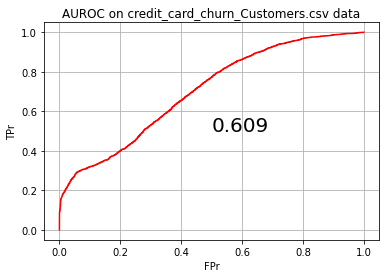

In [55]:
from sklearn.metrics import  roc_curve , roc_auc_score

fpr , tpr , thershold = roc_curve(y_test , pred_prob_test.iloc[: , 1] ) 

area_auroc = roc_auc_score(y_test , pred_log)
area_auroc_ = np.round(area_auroc , 3)
print('AUROC CURVE = ' , area_auroc_ )

plt.plot(fpr , tpr , color = "r")
plt.xlabel("FPr")
plt.ylabel("TPr")
plt.title("AUROC on credit_card_churn_Customers.csv data")
plt.text(x = 0.5 , y = 0.5, s = area_auroc_ , size = 20)
plt.grid()

# Decision Tree

In [56]:
from sklearn.model_selection import GridSearchCV

from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier()

search_dict = {"criterion" : ('entropy' , 'gini'),
              "max_depth" : ( 3,4,5,6,7,8,9),
              "min_samples_split": (25, 50 , 75, 100)}

grid_dt = GridSearchCV(dt , param_grid= search_dict)

grid_dt.fit(x_train , y_train )

grid_dt.best_params_
print('grid.best_params_ for DT -->' , grid_dt.best_params_ )

grid.best_params_ for DT --> {'criterion': 'entropy', 'max_depth': 9, 'min_samples_split': 25}


In [57]:
from sklearn.tree import DecisionTreeClassifier
dtc = DecisionTreeClassifier(criterion="entropy" , max_depth=9 , min_samples_split=25 , class_weight="balanced" )

dtc.fit(x_train , y_train )

pred_dtc = dtc.predict(x_test)
print('predicted value for DT --->' , pred_dtc)

from sklearn.metrics import confusion_matrix , classification_report

tab_dtc = confusion_matrix(pred_dtc , y_test)
print('\ntab for DT -->' , '\n' , tab_dtc ) 

print('\n' , classification_report( y_test , pred_dtc))

predicted value for DT ---> [0 1 0 ... 0 1 0]

tab for DT --> 
 [[5749  354]
 [1679 1976]]

               precision    recall  f1-score   support

           0       0.94      0.77      0.85      7428
           1       0.54      0.85      0.66      2330

    accuracy                           0.79      9758
   macro avg       0.74      0.81      0.76      9758
weighted avg       0.85      0.79      0.80      9758



# DT by ADA-BOOST

In [58]:
from sklearn.ensemble import AdaBoostClassifier

abc_dtc = AdaBoostClassifier(dtc , n_estimators=10)

abc_dtc.fit(x_train , y_train)

pred_dtc_boost = abc_dtc.predict(x_test)
print('predicted value for DT- by ada boost --->' , pred_dtc_boost)

from sklearn.metrics import confusion_matrix , classification_report

tab_dtc_boost = confusion_matrix(pred_dtc_boost , y_test)
print('\ntab for DT by ADA boost -->' , '\n' , tab_dtc_boost ) 

print('\n' , classification_report( y_test , pred_dtc_boost))

predicted value for DT- by ada boost ---> [0 1 1 ... 0 1 0]

tab for DT by ADA boost --> 
 [[6046  381]
 [1382 1949]]

               precision    recall  f1-score   support

           0       0.94      0.81      0.87      7428
           1       0.59      0.84      0.69      2330

    accuracy                           0.82      9758
   macro avg       0.76      0.83      0.78      9758
weighted avg       0.86      0.82      0.83      9758



# Random Forest

In [59]:
from sklearn.model_selection import GridSearchCV

from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()

search_rf = {"criterion" : ('entropy' , 'gini'),
              "max_depth" : (3,4,5,6,7),
              "n_estimators": (50, 100 , 150, 200)}

grid_rf = GridSearchCV(rf , param_grid= search_rf)

grid_rf.fit(x_train , y_train)

grid_rf.best_params_
print('grid.best_params_ for RF -->' , grid_rf.best_params_ )

grid.best_params_ for RF --> {'criterion': 'gini', 'max_depth': 7, 'n_estimators': 100}


In [60]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(criterion= 'entropy', max_depth= 7, n_estimators= 100 , class_weight="balanced")

rfc.fit(x_train , y_train )

pred_rfc = rfc.predict(x_test)
print('predicted value for RF --->' , pred_rfc)

from sklearn.metrics import confusion_matrix , classification_report

tab_rfc = confusion_matrix(pred_rfc , y_test)
print('\ntab for RF -->' , '\n' , tab_rfc ) 

print('\n' , classification_report( y_test , pred_rfc))

predicted value for RF ---> [0 1 1 ... 0 1 0]

tab for RF --> 
 [[5631  300]
 [1797 2030]]

               precision    recall  f1-score   support

           0       0.95      0.76      0.84      7428
           1       0.53      0.87      0.66      2330

    accuracy                           0.79      9758
   macro avg       0.74      0.81      0.75      9758
weighted avg       0.85      0.79      0.80      9758



# RF by ADA-BOOST

In [61]:
from sklearn.ensemble import AdaBoostClassifier
abc_rfc = AdaBoostClassifier(rfc)

abc_rfc.fit(x_train, y_train)

pred_rfc_boost = abc_rfc.predict(x_test)
print('predicted value for RF by ADA boost --->' , pred_rfc_boost)

from sklearn.metrics import confusion_matrix , classification_report

tab_rfc_boost = confusion_matrix(pred_rfc_boost , y_test)
print('\ntab for RF by ADA boost-->' , '\n' , tab_rfc_boost ) 

print('\n' , classification_report( y_test , pred_rfc_boost))

predicted value for RF by ADA boost ---> [0 1 1 ... 0 0 0]

tab for RF by ADA boost--> 
 [[6321  420]
 [1107 1910]]

               precision    recall  f1-score   support

           0       0.94      0.85      0.89      7428
           1       0.63      0.82      0.71      2330

    accuracy                           0.84      9758
   macro avg       0.79      0.84      0.80      9758
weighted avg       0.86      0.84      0.85      9758



# Naive Bayes

In [62]:
from sklearn.naive_bayes import MultinomialNB 
naive_bay = MultinomialNB()

nb = naive_bay.fit(x_train , y_train)

pred_nb = nb.predict(x_test)
print('predicted for naive bayes--->' ,pred_nb)

from sklearn.metrics import confusion_matrix , classification_report

tab_nb = confusion_matrix(pred_nb , y_test)
print('\ntab for naive bayes -->' , '\n' , tab_nb ) 

print(classification_report(y_test , pred_nb))

predicted for naive bayes---> [0 1 0 ... 0 0 0]

tab for naive bayes --> 
 [[7095 1815]
 [ 333  515]]
              precision    recall  f1-score   support

           0       0.80      0.96      0.87      7428
           1       0.61      0.22      0.32      2330

    accuracy                           0.78      9758
   macro avg       0.70      0.59      0.60      9758
weighted avg       0.75      0.78      0.74      9758



# KNN 

In [89]:
k=np.sqrt(df.shape[0])
k

220.88458524759034

In [90]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors= 100)

knn.fit(x_train, y_train)

pred_knn = knn.predict(x_test)
pred_knn

tab_knn = confusion_matrix(pred_knn , y_test)
tab_knn

print(classification_report(y_test , pred_knn))

              precision    recall  f1-score   support

           0       0.79      1.00      0.88      7428
           1       0.96      0.13      0.23      2330

    accuracy                           0.79      9758
   macro avg       0.87      0.56      0.55      9758
weighted avg       0.83      0.79      0.72      9758



# SMOTE - Synthetic Minority Over-sampling Technique 

In [66]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(sampling_strategy="minority")
x_train1, y_train1 = sm.fit_resample(x_train, y_train)

In [67]:
y_train1.value_counts()

1    29681
0    29681
Name: income, dtype: int64

# Logistic_Regression

In [68]:
from sklearn.linear_model import LogisticRegression
logreg= LogisticRegression()

logreg.fit(x_train1, y_train1)  

pred_log = logreg.predict(x_test)    
print('predicted value for logistic_reg --->' ,  pred_log)

from sklearn.metrics import confusion_matrix , classification_report
tab_log = confusion_matrix( pred_log , y_test)
print('\ntab for Logistic Regration -->' , '\n' , tab_log)

print('\n' , classification_report(y_test , pred_log))

predicted value for logistic_reg ---> [0 1 0 ... 0 0 0]

tab for Logistic Regration --> 
 [[5270 1016]
 [2158 1314]]

               precision    recall  f1-score   support

           0       0.84      0.71      0.77      7428
           1       0.38      0.56      0.45      2330

    accuracy                           0.67      9758
   macro avg       0.61      0.64      0.61      9758
weighted avg       0.73      0.67      0.69      9758



In [69]:
pred_prob_train = logreg.predict_proba(x_train1)
pred_prob_test  = logreg.predict_proba(x_test)

pred_prob_test = pd.DataFrame(pred_prob_test)

pred_prob_test.rename(columns ={pred_prob_test.columns[0]: "Pred_Prob0" , 
                                pred_prob_test.columns[1]: "Pred_prob1"} , inplace = True)

print('\npred_prob_test--->\n' , pred_prob_test)


pred_prob_test--->
       Pred_Prob0  Pred_prob1
0       0.636215    0.363785
1       0.007529    0.992471
2       0.594524    0.405476
3       0.673360    0.326640
4       0.547435    0.452565
...          ...         ...
9753    0.606950    0.393050
9754    0.750020    0.249980
9755    0.622974    0.377026
9756    0.529140    0.470860
9757    0.707465    0.292535

[9758 rows x 2 columns]


AUROC CURVE =  0.637


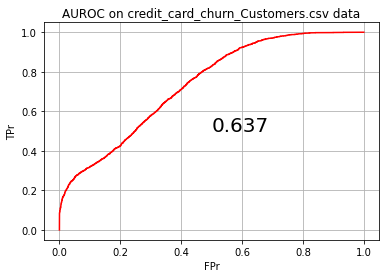

In [70]:
from sklearn.metrics import  roc_curve , roc_auc_score

fpr , tpr , thershold = roc_curve(y_test , pred_prob_test.iloc[: , 1] ) 

area_auroc = roc_auc_score(y_test , pred_log)
area_auroc_ = np.round(area_auroc , 3)
print('AUROC CURVE = ' , area_auroc_ )

plt.plot(fpr , tpr , color = "r")
plt.xlabel("FPr")
plt.ylabel("TPr")
plt.title("AUROC on credit_card_churn_Customers.csv data")
plt.text(x = 0.5 , y = 0.5, s = area_auroc_ , size = 20)
plt.grid()

# Decision Tree

In [71]:
from sklearn.model_selection import GridSearchCV

from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier()

search_dict = {"criterion" : ('entropy' , 'gini'),
              "max_depth" : ( 3,4,5,6,7,8,9),
              "min_samples_split": (25, 50 , 75, 100)}

grid_dt = GridSearchCV(dt , param_grid= search_dict)

grid_dt.fit(x_train1, y_train1 )

grid_dt.best_params_
print('grid.best_params_ for DT -->' , grid_dt.best_params_ )

grid.best_params_ for DT --> {'criterion': 'gini', 'max_depth': 9, 'min_samples_split': 25}


In [72]:
dtc = DecisionTreeClassifier(criterion="gini" , max_depth=9 , min_samples_split=25 , class_weight="balanced" )

dtc.fit(x_train1, y_train1)

pred_dtc = dtc.predict(x_test)
print('predicted value for DT --->' , pred_dtc)

from sklearn.metrics import confusion_matrix , classification_report

tab_dtc = confusion_matrix(pred_dtc , y_test)
print('\ntab for DT -->' , '\n' , tab_dtc ) 

print('\n' , classification_report( y_test , pred_dtc))

predicted value for DT ---> [0 1 0 ... 0 0 0]

tab for DT --> 
 [[6362  673]
 [1066 1657]]

               precision    recall  f1-score   support

           0       0.90      0.86      0.88      7428
           1       0.61      0.71      0.66      2330

    accuracy                           0.82      9758
   macro avg       0.76      0.78      0.77      9758
weighted avg       0.83      0.82      0.83      9758



# DT by ADA-BOOST

In [73]:
from sklearn.ensemble import AdaBoostClassifier

abc_dtc = AdaBoostClassifier(dtc , n_estimators=10)

abc_dtc.fit(x_train1, y_train1)

pred_dtc_boost = abc_dtc.predict(x_test)
print('predicted value for DT- by ada boost --->' , pred_dtc_boost)

from sklearn.metrics import confusion_matrix , classification_report

tab_dtc_boost = confusion_matrix(pred_dtc_boost , y_test)
print('\ntab for DT by ADA boost -->' , '\n' , tab_dtc_boost ) 

print('\n' , classification_report( y_test , pred_dtc_boost))

predicted value for DT- by ada boost ---> [0 1 0 ... 0 0 0]

tab for DT by ADA boost --> 
 [[6731  848]
 [ 697 1482]]

               precision    recall  f1-score   support

           0       0.89      0.91      0.90      7428
           1       0.68      0.64      0.66      2330

    accuracy                           0.84      9758
   macro avg       0.78      0.77      0.78      9758
weighted avg       0.84      0.84      0.84      9758



# Random Forest

In [74]:
from sklearn.model_selection import GridSearchCV

from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()

search_rf = {"criterion" : ('entropy' , 'gini'),
              "max_depth" : (3,4,5,6,7),
              "n_estimators": (50, 100 , 150, 200)}

grid_rf = GridSearchCV(rf , param_grid= search_rf)

grid_rf.fit(x_train , y_train)

grid_rf.best_params_
print('grid.best_params_ for RF -->' , grid_rf.best_params_ )

grid.best_params_ for RF --> {'criterion': 'gini', 'max_depth': 7, 'n_estimators': 200}


In [75]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(criterion= 'gini', max_depth= 7, n_estimators= 200 , class_weight="balanced")

rfc.fit(x_train1, y_train1 )

pred_rfc = rfc.predict(x_test)
print('predicted value for RF --->' , pred_rfc)

from sklearn.metrics import confusion_matrix , classification_report

tab_rfc = confusion_matrix(pred_rfc , y_test)
print('\ntab for RF -->' , '\n' , tab_rfc ) 

print('\n' , classification_report( y_test , pred_rfc))

predicted value for RF ---> [0 1 0 ... 0 0 0]

tab for RF --> 
 [[6347  631]
 [1081 1699]]

               precision    recall  f1-score   support

           0       0.91      0.85      0.88      7428
           1       0.61      0.73      0.66      2330

    accuracy                           0.82      9758
   macro avg       0.76      0.79      0.77      9758
weighted avg       0.84      0.82      0.83      9758



# RF by ADA-BOOST

In [76]:
from sklearn.ensemble import AdaBoostClassifier
abc_rfc = AdaBoostClassifier(rfc)

abc_rfc.fit(x_train1, y_train1)

pred_rfc_boost = abc_rfc.predict(x_test)
print('predicted value for RF by ADA boost --->' , pred_rfc_boost)

from sklearn.metrics import confusion_matrix , classification_report

tab_rfc_boost = confusion_matrix(pred_rfc_boost , y_test)
print('\ntab for RF by ADA boost-->' , '\n' , tab_rfc_boost ) 

print('\n' , classification_report( y_test , pred_rfc_boost))

predicted value for RF by ADA boost ---> [0 1 0 ... 0 0 0]

tab for RF by ADA boost--> 
 [[6909  810]
 [ 519 1520]]

               precision    recall  f1-score   support

           0       0.90      0.93      0.91      7428
           1       0.75      0.65      0.70      2330

    accuracy                           0.86      9758
   macro avg       0.82      0.79      0.80      9758
weighted avg       0.86      0.86      0.86      9758



# Naive Bayes

In [77]:
from sklearn.naive_bayes import MultinomialNB 
naive_bay = MultinomialNB()

nb = naive_bay.fit(x_train1, y_train1)

pred_nb = nb.predict(x_test)
print('predicted for naive bayes--->' ,pred_nb)

from sklearn.metrics import confusion_matrix , classification_report

tab_nb = confusion_matrix(pred_nb , y_test)
print('\ntab for naive bayes -->' , '\n' , tab_nb ) 

print(classification_report(y_test , pred_nb))

predicted for naive bayes---> [0 1 0 ... 0 0 0]

tab for naive bayes --> 
 [[7097 1818]
 [ 331  512]]
              precision    recall  f1-score   support

           0       0.80      0.96      0.87      7428
           1       0.61      0.22      0.32      2330

    accuracy                           0.78      9758
   macro avg       0.70      0.59      0.60      9758
weighted avg       0.75      0.78      0.74      9758



# KNN 

In [87]:
k=np.sqrt(df.shape[0])
k

220.88458524759034

In [88]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors= 100)

knn.fit(x_train1, y_train1)

pred_knn = knn.predict(x_test)
pred_knn

tab_knn = confusion_matrix(pred_knn , y_test)
tab_knn

print(classification_report(y_test , pred_knn))

              precision    recall  f1-score   support

           0       0.81      0.79      0.80      7428
           1       0.38      0.41      0.39      2330

    accuracy                           0.70      9758
   macro avg       0.59      0.60      0.60      9758
weighted avg       0.71      0.70      0.70      9758



# Conclusion:-

 * ** In this case-study we constructed a model that is able to accurately predict whether an individual earns over $50k/yr 
based on various data like marital status, education, age or nationality. 

 * **befor over sampling and after over sampling comparing all models Random forest with ADA-BOOST give ACC= 86%  precision = 90% , recall= 93% , f1-score = 91% . 
 * **Model gives best result on Random forest with ADA-BOOST.
 * **my final conclusion is Random forest with ADA-BOOST is best model and its gives best result on this dataset to predict whether the income of an adult will exceed $50k per year or not based on the individual’s personal information.

# Business Insight

* **Many businesses would like to personalize their offer based on customer’s income. 
* **High-income customers could be, for instance, exposed to premium products. 
* **As a customer’s income is not always explicitly known, predictive model could estimate income of a person based on other information.